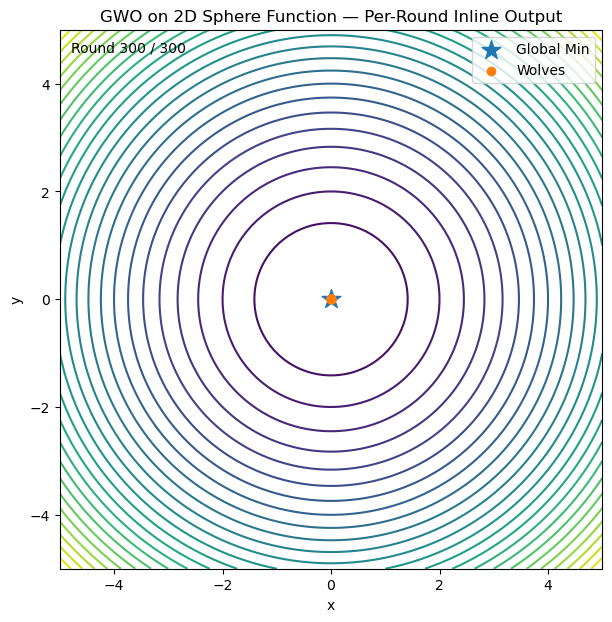

In [ ]:
# Inline display that updates the same output "per round" with ~1s delay
# (no seaborn, one plot at a time, default colors)
import numpy as np
import matplotlib.pyplot as plt
import time
from IPython.display import display, clear_output

# -------------------------------
# กำหนดค่าพื้นฐาน
n_rounds = 100
n_wolves = 20
dim = 30
domain = [-5, 5]

def f(pos):
    return np.sum(pos**2)

# สุ่มตำแหน่งหมาป่า
rng = np.random.default_rng()
wolves = [rng.uniform(domain[0], domain[1], dim) for _ in range(n_wolves)]

# ประวัติตำแหน่งแต่ละรอบ
positions_history = []


for k in range(n_rounds):
    sorted_idx = sorted(range(n_wolves), key=lambda i: f(wolves[i]))
    X_alpha, X_beta, X_delta = wolves[sorted_idx[0]], wolves[sorted_idx[1]], wolves[sorted_idx[2]]

    # เก็บตำแหน่งก่อนอัปเดตในรอบนี้
    positions_history.append(np.array(wolves))

    # อัปเดตหมาป่า
    for i in range(n_wolves):
        X = wolves[i]
        C1, C2, C3 = rng.uniform(0, 2, dim), rng.uniform(0, 2, dim), rng.uniform(0, 2, dim)
        lower, upper = -1 + k / n_rounds, 1 - k / n_rounds
        A1, A2, A3 = rng.uniform(lower, upper, dim), rng.uniform(lower, upper, dim), rng.uniform(lower, upper, dim)
        D_alpha = np.abs(C1 * X_alpha - X)
        D_beta  = np.abs(C2 * X_beta  - X)
        D_delta = np.abs(C3 * X_delta - X)
        X1 = X_alpha - A1 * D_alpha
        X2 = X_beta  - A2 * D_beta
        X3 = X_delta - A3 * D_delta
        X_new = (X1 + X2 + X3) / 3
        wolves[i] = np.clip(X_new, domain[0], domain[1])

# -------------------------------
# เตรียมพื้นผิว contour
x = np.linspace(domain[0], domain[1], 100)
y = np.linspace(domain[0], domain[1], 100)
X, Y = np.meshgrid(x, y)
Z = X**2 + Y**2

# -------------------------------
# แสดงผลแบบ "อัปเดตใน output เดียว" ทีละรอบ
fig, ax = plt.subplots(figsize=(7, 7))
ax.set_xlim(domain[0], domain[1])
ax.set_ylim(domain[0], domain[1])
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_title("GWO on 2D Sphere Function — Per-Round Inline Output")

# วาด contour คงที่
ax.contour(X, Y, Z, levels=30)

# จุด global minimum
ax.scatter([0], [0], marker='*', s=200, label='Global Min')

# สร้าง scatter สำหรับหมาป่า (เฟรมแรก)
scat = ax.scatter(positions_history[0][:, 0], positions_history[0][:, 1], label="Wolves")

txt = ax.text(0.02, 0.98, f"Round 1 / {len(positions_history)}", transform=ax.transAxes,
              ha="left", va="top")
ax.legend(loc="upper right")

# วนแสดงรายรอบ
for t, pos in enumerate(positions_history, start=1):
    if t % 5 == 0:
        scat.set_offsets(pos[:, :2])
        txt.set_text(f"Round {t} / {len(positions_history)}")
        clear_output(wait=True)
        display(fig)
        plt.pause(0.001)  # ให้ matplotlib วาดเฟรม
        time.sleep(0.25)     # ดีเลย์ ~1 วินาที

plt.close(fig)

<h1> ----------------------------------------------------------
<h2> By animation

In [3]:
# GWO on 2D Sphere — Animation with controls (FuncAnimation + to_jshtml)
# ------------------------------------------------------------
# - no seaborn
# - single figure
# - default matplotlib colors (ไม่กำหนดสีเอง)
# ------------------------------------------------------------

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

# -------------------------------
# กำหนดค่าพื้นฐาน
n_rounds = 100        # จำนวนรอบอัปเดต
n_wolves = 20         # จำนวนหมาป่า
dim = 30              # มิติการค้นหา (พล็อตแค่ 2 มิติแรก)
domain = [-5, 5]      # โดเมนค้นหา

# ฟังก์ชันเป้าหมาย: Sphere
def f(pos):
    pos = np.asarray(pos)
    return np.sum(pos**2)

# -------------------------------
# เตรียมประชากรเริ่มต้น
rng = np.random.default_rng()
wolves = [rng.uniform(domain[0], domain[1], dim) for _ in range(n_wolves)]

# เก็บตำแหน่งหมาป่าทุก ๆ รอบ (ก่อนอัปเดตในรอบนั้น)
positions_history = []

# -------------------------------
# วนทำ GWO
for k in range(n_rounds):
    # จัดอันดับ alpha, beta, delta (ค่าน้อยดีกว่า)
    sorted_idx = sorted(range(n_wolves), key=lambda i: f(wolves[i]))
    X_alpha, X_beta, X_delta = (
        wolves[sorted_idx[0]],
        wolves[sorted_idx[1]],
        wolves[sorted_idx[2]],
    )

    # เก็บตำแหน่งของรอบนี้ (ก่อนอัปเดต)
    positions_history.append(np.array(wolves))

    # อัปเดตหมาป่าทั้งฝูง
    for i in range(n_wolves):
        X = wolves[i]
        C1, C2, C3 = rng.uniform(0, 2, dim), rng.uniform(0, 2, dim), rng.uniform(0, 2, dim)
        lower, upper = -1 + k / n_rounds, 1 - k / n_rounds
        A1, A2, A3 = rng.uniform(lower, upper, dim), rng.uniform(lower, upper, dim), rng.uniform(lower, upper, dim)

        D_alpha = np.abs(C1 * X_alpha - X)
        D_beta  = np.abs(C2 * X_beta  - X)
        D_delta = np.abs(C3 * X_delta - X)

        X1 = X_alpha - A1 * D_alpha
        X2 = X_beta  - A2 * D_beta
        X3 = X_delta - A3 * D_delta

        X_new = (X1 + X2 + X3) / 3.0
        wolves[i] = np.clip(X_new, domain[0], domain[1])

# -------------------------------
# เตรียมพื้นผิวสำหรับ contour plot (2D: ใช้มิติแรกสองมิติ)
x = np.linspace(domain[0], domain[1], 100)
y = np.linspace(domain[0], domain[1], 100)
X, Y = np.meshgrid(x, y)
Z = X**2 + Y**2  # Sphere 2D

# -------------------------------
# สร้างแอนิเมชัน (มีปุ่มควบคุม)
fig, ax = plt.subplots(figsize=(7, 7))
ax.set_xlim(domain[0], domain[1])
ax.set_ylim(domain[0], domain[1])
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_title("GWO on 2D Sphere Function — Animation")

# วาดคอนทัวร์ครั้งเดียว
ax.contour(X, Y, Z, levels=30)

# จุด global minimum
ax.scatter([0], [0], marker='*', s=200, label='Global Min')

# จุดหมาป่า + ข้อความบอกรอบ
scat = ax.scatter(positions_history[0][:, 0], positions_history[0][:, 1], label="Wolves")
txt = ax.text(0.02, 0.98, "", transform=ax.transAxes, ha="left", va="top")

ax.legend(loc="upper right")

def init():
    scat.set_offsets(positions_history[0][:, :2])
    txt.set_text(f"Round 1 / {len(positions_history)}")
    return scat, txt

def update(frame):
    pos = positions_history[frame][:, :2]
    scat.set_offsets(pos)
    txt.set_text(f"Round {frame+1} / {len(positions_history)}")
    return scat, txt

# interval หน่วยเป็นมิลลิวินาที (เช่น 250 = 0.25s/เฟรม)
anim = FuncAnimation(
    fig,
    update,
    init_func=init,
    frames=len(positions_history),
    # frames=n_rounds,
    interval=250,
    blit=False,
    repeat=True,
)

# แสดงเป็นแอนิเมชันแบบมีปุ่มควบคุมในโน้ตบุ๊ก
html = anim.to_jshtml()
plt.close(fig)  # ปิด figure เดิมเพื่อไม่ให้ซ้อนซ้ำในเอาต์พุต
display(HTML(html))

# ------------------------------------------------------------
# ถ้าต้องการบันทึกเป็น GIF (เลือกใช้ได้ ถ้ามี pillow ติดตั้ง)
# from matplotlib.animation import PillowWriter
# anim.save("gwo_sphere.gif", writer=PillowWriter(fps=4))  # 4 เฟรม/วินาที
# ------------------------------------------------------------


Animation size has reached 21044793 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


<h1> NO Animation

In [22]:
import numpy as np

# -------------------------------
# พารามิเตอร์
n_rounds = 500        # จำนวนรอบย่อยต่อชุด
extra_rounds = 10     # จำนวนชุด (ลูปใหญ่)
n_wolves = 5
dim = 30
domain = [-5, 5]
reset_each_set = False   # ถ้าอยากรีเซ็ตฝูงทุกชุด ให้ตั้งเป็น True

def f(pos):
    pos = np.asarray(pos)
    return np.sum(pos**2)

# -------------------------------
# สุ่มตำแหน่งหมาป่าเริ่มต้น
rng = np.random.default_rng(0)
wolves0 = [rng.uniform(domain[0], domain[1], dim) for _ in range(n_wolves)]
wolves = [w.copy() for w in wolves0]

# อัปเดต 1 รอบและคืนค่า f(best) หลังอัปเดต
def step(k, total_rounds):
    # จัดอันดับ alpha/beta/delta
    sorted_idx = sorted(range(n_wolves), key=lambda i: f(wolves[i]))
    X_alpha, X_beta, X_delta = wolves[sorted_idx[0]], wolves[sorted_idx[1]], wolves[sorted_idx[2]]

    # อัปเดตหมาป่าทั้งฝูง
    for i in range(n_wolves):
        X = wolves[i]
        C1, C2, C3 = rng.uniform(0, 2, dim), rng.uniform(0, 2, dim), rng.uniform(0, 2, dim)
        lower, upper = -1 + k / total_rounds, 1 - k / total_rounds
        A1, A2, A3 = rng.uniform(lower, upper, dim), rng.uniform(lower, upper, dim), rng.uniform(lower, upper, dim)

        D_alpha = np.abs(C1 * X_alpha - X)
        D_beta  = np.abs(C2 * X_beta  - X)
        D_delta = np.abs(C3 * X_delta - X)

        X1 = X_alpha - A1 * D_alpha
        X2 = X_beta  - A2 * D_beta
        X3 = X_delta - A3 * D_delta

        X_new = (X1 + X2 + X3) / 3
        wolves[i] = np.clip(X_new, domain[0], domain[1])

    # คืนค่า best หลังอัปเดตรอบนี้
    best_idx = min(range(n_wolves), key=lambda i: f(wolves[i]))
    return f(wolves[best_idx])

# -------------------------------
# ลูปซ้อนลูป + คำนวณค่าเฉลี่ยของค่ารอบสุดท้ายที่ดีที่สุดในแต่ละชุด
final_bests_across_sets = []

for outer in range(extra_rounds):
    if reset_each_set:
        # รีเซ็ตฝูงใหม่ทุกชุด (ถ้าต้องการ)
        wolves = [w.copy() for w in wolves0]

    best_values = []
    for inner in range(n_rounds):
        best_values.append(step(inner, total_rounds=n_rounds))

    final_best = best_values[-1]   # ค่ารอบสุดท้ายของลูปย่อยในชุดนี้
    final_bests_across_sets.append(final_best)
    print(f"[ชุดที่ {outer+1}] f(best)_รอบสุดท้าย = {final_best:.6f}")

# ค่าเฉลี่ยของ “ค่ารอบสุดท้ายที่ดีที่สุด” ข้ามทุกชุด
avg_of_final_bests = float(np.mean(final_bests_across_sets))
print(f"\nค่าเฉลี่ยของ f(best)_รอบสุดท้าย ใน {extra_rounds} ชุด = {avg_of_final_bests:.6f}")


[ชุดที่ 1] f(best)_รอบสุดท้าย = 0.001138
[ชุดที่ 2] f(best)_รอบสุดท้าย = 0.000000
[ชุดที่ 3] f(best)_รอบสุดท้าย = 0.000000
[ชุดที่ 4] f(best)_รอบสุดท้าย = 0.000000
[ชุดที่ 5] f(best)_รอบสุดท้าย = 0.000000
[ชุดที่ 6] f(best)_รอบสุดท้าย = 0.000000
[ชุดที่ 7] f(best)_รอบสุดท้าย = 0.000000
[ชุดที่ 8] f(best)_รอบสุดท้าย = 0.000000
[ชุดที่ 9] f(best)_รอบสุดท้าย = 0.000000
[ชุดที่ 10] f(best)_รอบสุดท้าย = 0.000000

ค่าเฉลี่ยของ f(best)_รอบสุดท้าย ใน 10 ชุด = 0.000114
